In [42]:
import pm4py
import pandas as pd

### NoNoise

In [43]:
event_log = pm4py.read_xes(r"NoNoise.xes")

parsing log, completed traces :: 100%|██████████| 101/101 [00:00<00:00, 382.55it/s]


In [44]:
start_activities = pm4py.get_start_activities(event_log)
end_activities = pm4py.get_end_activities(event_log)

In [45]:
print("Start activities: {}\nEnd activities: {}".format(start_activities, end_activities))

Start activities: {'A': 101}
End activities: {'H': 101}


In [46]:
process_tree = pm4py.discover_process_tree_inductive(event_log)

In [47]:
bpmn_model = pm4py.convert_to_bpmn(process_tree)

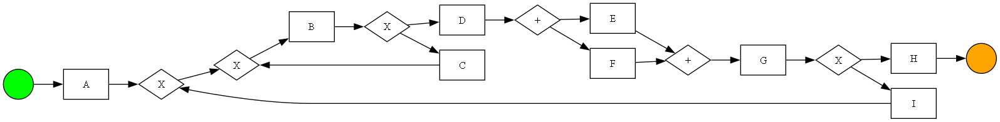

In [48]:
pm4py.view_bpmn(bpmn_model)

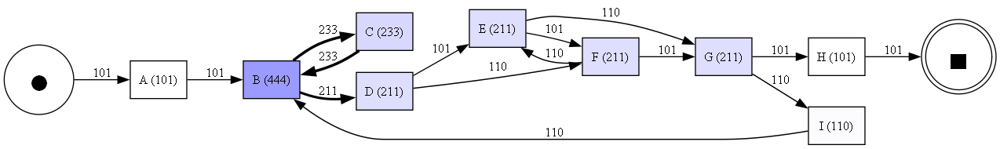

In [49]:
dfg = pm4py.discover_dfg(event_log)
pm4py.view_dfg(*dfg)

In [105]:
import pm4py
from pm4py.objects.log.importer.xes import importer as xes_importer
from collections import Counter

# Replace 'path_to_log.xes' with your actual XES file path
log = xes_importer.apply('Road_Traffic_Fine_Management_Process.xes')

parsing log, completed traces :: 100%|██████████| 150370/150370 [00:50<00:00, 2998.36it/s]


[(('Create Fine',
   'Send Fine',
   'Insert Fine Notification',
   'Add penalty',
   'Send for Credit Collection'),
  56482),
 (('Create Fine', 'Payment'), 46371),
 (('Create Fine', 'Send Fine'), 20385),
 (('Create Fine',
   'Send Fine',
   'Insert Fine Notification',
   'Add penalty',
   'Payment'),
  9520),
 (('Create Fine',
   'Send Fine',
   'Insert Fine Notification',
   'Add penalty',
   'Payment',
   'Payment'),
  3736)]

In [108]:
for trace in log:
    print(trace)

{'attributes': {'concept:name': 'A1'}, 'events': [{'amount': 35.0, 'org:resource': '561', 'dismissal': 'NIL', 'concept:name': 'Create Fine', 'vehicleClass': 'A', 'totalPaymentAmount': 0.0, 'lifecycle:transition': 'complete', 'time:timestamp': datetime.datetime(2006, 7, 24, 0, 0, tzinfo=datetime.timezone.utc), 'article': 157, 'points': 0}, '..', {'concept:name': 'Send Fine', 'lifecycle:transition': 'complete', 'expense': 11.0, 'time:timestamp': datetime.datetime(2006, 12, 5, 0, 0, tzinfo=datetime.timezone.utc)}]}
{'attributes': {'concept:name': 'A100'}, 'events': [{'amount': 35.0, 'org:resource': '561', 'dismissal': 'NIL', 'concept:name': 'Create Fine', 'vehicleClass': 'A', 'totalPaymentAmount': 0.0, 'lifecycle:transition': 'complete', 'time:timestamp': datetime.datetime(2006, 8, 2, 0, 0, tzinfo=datetime.timezone.utc), 'article': 157, 'points': 0}, '..', {'concept:name': 'Send for Credit Collection', 'lifecycle:transition': 'complete', 'time:timestamp': datetime.datetime(2009, 3, 30, 0,

KeyboardInterrupt: 

In [106]:
traces = [tuple(event['concept:name'] for event in trace) for trace in log]
trace_counts = Counter(traces)
trace_counts.most_common(5)

[(('Create Fine',
   'Send Fine',
   'Insert Fine Notification',
   'Add penalty',
   'Send for Credit Collection'),
  56482),
 (('Create Fine', 'Payment'), 46371),
 (('Create Fine', 'Send Fine'), 20385),
 (('Create Fine',
   'Send Fine',
   'Insert Fine Notification',
   'Add penalty',
   'Payment'),
  9520),
 (('Create Fine',
   'Send Fine',
   'Insert Fine Notification',
   'Add penalty',
   'Payment',
   'Payment'),
  3736)]

regex: 'Payment'(.)*'Send for Credit Collection'

In [133]:
import pm4py
from pm4py.objects.log.importer.xes import importer as xes_importer
from pm4py.statistics.start_activities.log import get as start_activities_get   
from pm4py.statistics.end_activities.log import get as end_activities_get

# Load the event log (replace with your log file path)
# log = xes_importer.apply('path_to_event_log.xes')

# Get the start activities and their counts
start_activities = start_activities_get.get_start_activities(log)

# Get the end activities and their counts
end_activities = end_activities_get.get_end_activities(log)

# Print the results
print("Start activities:", start_activities)
print("End activities:", end_activities)

most_common_start = max(start_activities, key=start_activities.get)
most_common_end = max(end_activities, key=end_activities.get)

print("Most common start activity:", most_common_start)
print("Most common end activity:", most_common_end)


Start activities: {'Create Fine': 150370}
End activities: {'Send Fine': 20755, 'Send for Credit Collection': 58997, 'Payment': 67201, 'Send Appeal to Prefecture': 3144, 'Appeal to Judge': 134, 'Notify Result Appeal to Offender': 86, 'Receive Result Appeal from Prefecture': 53}
Most common start activity: Create Fine
Most common end activity: Payment


### Filter based on Variance

In [91]:
from collections import defaultdict
import numpy as np
import pandas as pd

In [92]:
log = pm4py.read_xes("NoNoise.xes")

parsing log, completed traces :: 100%|██████████| 101/101 [00:00<00:00, 887.21it/s]


In [93]:
log

,concept:instance,lifecycle:transition,concept:name,concept:simulated,time:timestamp,case:concept:name,case:simulated:logProbability
0,0,complete,A,True,2017-02-21 09:48:26.543000+00:00,tr_0,-2.079442
1,0,complete,B,True,2017-02-21 09:48:51.147000+00:00,tr_0,-2.079442
2,0,complete,D,True,2017-02-21 09:49:23.572000+00:00,tr_0,-2.079442
3,0,complete,F,True,2017-02-21 09:49:23.939000+00:00,tr_0,-2.079442
4,0,complete,E,True,2017-02-21 09:50:20.163000+00:00,tr_0,-2.079442
...,...,...,...,...,...,...,...
1828,100,complete,D,True,2017-02-21 09:58:50.543000+00:00,tr_100,-6.931472
1829,100,complete,F,True,2017-02-21 09:59:39.617000+00:00,tr_100,-6.931472
1830,100,complete,E,True,2017-02-21 09:59:57.994000+00:00,tr_100,-6.931472
1831,100,complete,G,True,2017-02-21 10:00:02.102000+00:00,tr_100,-6.931472


In [95]:
for trace in log:
    print

In [53]:
# Step 1: Get a list of all activities and their occurrences per trace
activity_occurrences = defaultdict(list)

for index, row in log.iterrows(): 
    activity_count = defaultdict(int)
    # Append count of activities in the trace to the dictionary
    for activity, count in activity_count.items():
        activity_occurrences[activity].append(count)

{'Create Fine': 150370, 'Send Fine': 103987, 'Insert Fine Notification': 79860, 'Add penalty': 79860, 'Send for Credit Collection': 59013, 'Payment': 77601, 'Insert Date Appeal to Prefecture': 4188, 'Send Appeal to Prefecture': 4141, 'Receive Result Appeal from Prefecture': 999, 'Notify Result Appeal to Offender': 896, 'Appeal to Judge': 555}


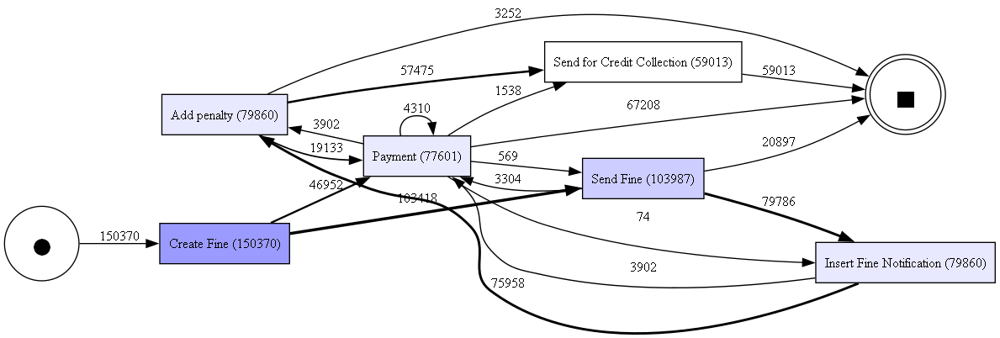

In [111]:
import pm4py
from pm4py.algo.filtering.log.attributes import attributes_filter

# Load the event log
# log = pm4py.read_xes("NoNoise.xes")

# Get activity frequencies from the event log
activity_freq = pm4py.get_event_attribute_values(log, "concept:name")
print(activity_freq)

# Set a threshold to filter activities by frequency (slider-based)
activity_threshold = 47000 # Example: Keep activities that appear at least 50 times

# Filter activities based on the threshold, keeping only events that meet the frequency condition
activities_to_keep = {activity for activity, freq in activity_freq.items() if freq > activity_threshold}
filtered_log_by_activities = attributes_filter.apply_events(log, activities_to_keep, parameters={
    attributes_filter.Parameters.ATTRIBUTE_KEY: "concept:name"
})


dfg_filtered_by_log_activities = pm4py.discover_dfg(filtered_log_by_activities)
pm4py.view_dfg(*dfg_filtered_by_log_activities)

# Save or analyze the filtered log
# pm4py.write_xes(filtered_log_by_activities, "filtered_log_by_activities.xes")


In [79]:
from pm4py.algo.discovery.dfg.adapters.pandas.freq_triples import get_freq_triples
get_freq_triples(log, activity_key='concept:name', case_id_glue='case:concept:name', timestamp_key='time:timestamp')

{('A', 'B', 'C'): 62,
 ('A', 'B', 'D'): 39,
 ('B', 'C', 'B'): 233,
 ('B', 'D', 'E'): 101,
 ('B', 'D', 'F'): 110,
 ('C', 'B', 'C'): 122,
 ('C', 'B', 'D'): 111,
 ('D', 'E', 'F'): 101,
 ('D', 'F', 'E'): 110,
 ('E', 'F', 'G'): 101,
 ('E', 'G', 'H'): 51,
 ('E', 'G', 'I'): 59,
 ('F', 'E', 'G'): 110,
 ('F', 'G', 'H'): 50,
 ('F', 'G', 'I'): 51,
 ('G', 'I', 'B'): 110,
 ('I', 'B', 'C'): 49,
 ('I', 'B', 'D'): 61}

In [58]:
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery
from pm4py.algo.filtering.dfg import dfg_filtering

# Discover the DFG from the event log
dfg = dfg_discovery.apply(log)

# Set a threshold for the number of times a transition should occur to be kept
transition_threshold = 30  # Example: Keep connections that appear at least 30 times

# Filter DFG edges based on the transition threshold
filtered_dfg = {edge: freq for edge, freq in dfg.items() if freq >= transition_threshold}

# Filter the event log based on the filtered DFG
filtered_log_by_connections = dfg_filtering.apply(log, filtered_dfg)

# Save or analyze the filtered log
pm4py.write_xes(filtered_log_by_connections, "filtered_log_by_connections.xes")


AttributeError: module 'pm4py.algo.filtering.dfg.dfg_filtering' has no attribute 'apply'

In [72]:
import pm4py
from pm4py.algo.filtering.log.attributes import attributes_filter
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery
from pm4py.objects.log.obj import EventLog

# Load the event log
log = pm4py.read_xes("NoNoise.xes")

# ---------------- Activity Cropping (Upper Slider) ---------------- #
# Get activity frequencies from the event log
activity_freq = pm4py.get_event_attribute_values(log, "concept:name")

# Set a threshold to filter activities by frequency (slider-based)
activity_threshold = 50  # Example: Keep activities that appear at least 50 times

# Filter activities based on the threshold
activities_to_keep = {activity for activity, freq in activity_freq.items() if freq > activity_threshold}
filtered_log_by_activities = attributes_filter.apply_events(log, activities_to_keep, parameters={
    attributes_filter.Parameters.ATTRIBUTE_KEY: "concept:name"
})

# ---------------- Connection Cropping (Bottom Slider) ---------------- #
# Discover the DFG from the filtered log (after activity filtering)
dfg = dfg_discovery.apply(filtered_log_by_activities)

# Set a threshold for the number of times a transition should occur to be kept
transition_threshold = 102  # Example: Keep connections that appear at least 30 times

# Filter DFG edges based on the transition threshold
filtered_dfg = {edge: freq for edge, freq in dfg.items() if freq >= transition_threshold}

# Function to check if a trace should be kept based on filtered DFG
def trace_contains_valid_transitions(trace, filtered_dfg):
    for i in range(len(trace) - 1):
        event_a = trace[i]['concept:name']
        event_b = trace[i + 1]['concept:name']
        if (event_a, event_b) not in filtered_dfg:
            return False
    return True

# Create a new log with traces that meet the connection criteria
filtered_log_final = EventLog([trace for trace in filtered_log_by_activities if trace_contains_valid_transitions(trace, filtered_dfg)])

dfg_filtered_log_final = pm4py.discover_dfg(filtered_log_final)
pm4py.view_dfg(*dfg_filtered_log_final)

# Save or analyze the final filtered log
pm4py.write_xes(filtered_log_final, "final_filtered_log.xes")


parsing log, completed traces :: 100%|██████████| 101/101 [00:00<00:00, 884.36it/s]


exporting log, completed traces :: : 0it [00:00, ?it/s]
